# Preprocessing Experiment 1

## Initialisation and reading data

In [1]:
import numpy as np                                # scientific computing toolkit
import pandas as pd                               # data analysis toolkit
import scanpy as sc                               # scanpy is referred to with sc.***
import scvelo as scv                              # RNA velocity toolkit
import matplotlib.pyplot as plt                   # Matplotlib is referred to with plt.***
from scipy import stats                           # for linear regressions
import seaborn as sns                             # for easy heatmaps
from simple_venn import venn3, venn4              # Venn diagrams
import scirpy as ir

sc.settings.verbosity = 1                         # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()                       # check if all needed versions are installed and up to date
results_file = './write/results.h5ad'             # the file that will store the analysis results

scanpy==1.4.3 anndata==0.7.5 umap==0.4.6 numpy==1.19.4 scipy==1.5.1 pandas==1.1.5 scikit-learn==0.21.3 statsmodels==0.11.1 python-igraph==0.7.1+4.bed07760 louvain==0.6.1 leidenalg==0.7.0


In [2]:
sc.settings.set_figure_params(dpi=80, dpi_save=200, color_map='viridis')

In [3]:
adata_1 = sc.read_10x_mtx(
    "./GEX_1/GEX/filtered_feature_bc_matrix/",  # the directory with the `.mtx` file
    var_names='gene_symbols',                  # use gene symbols for the variable names (variables-axis index)
    cache=True)                                # write a cache file for faster subsequent reading
adata_1.var_names_make_unique()  # this is unnecessary if using 'gene_ids'
adata_1   # Gives an output of the actual variables stored in adata (cells x genes)

AnnData object with n_obs × n_vars = 8301 × 33538
    var: 'gene_ids', 'feature_types'

In [4]:
adata_2 = sc.read_10x_mtx(
    "./GEX_2/GEX/filtered_feature_bc_matrix/",  # the directory with the `.mtx` file
    var_names='gene_symbols',                  # use gene symbols for the variable names (variables-axis index)
    cache=True)                                # write a cache file for faster subsequent reading
adata_2.var_names_make_unique()  # this is unnecessary if using 'gene_ids'
adata_2   # Gives an output of the actual variables stored in adata (cells x genes)

AnnData object with n_obs × n_vars = 6367 × 33538
    var: 'gene_ids', 'feature_types'

In [5]:
adatas = [adata_1,adata_2]
names = ["Sample 1", "Sample 2"]

## Preprocessing

Show those genes that yield the highest fraction of counts in each single cells, across all cells.

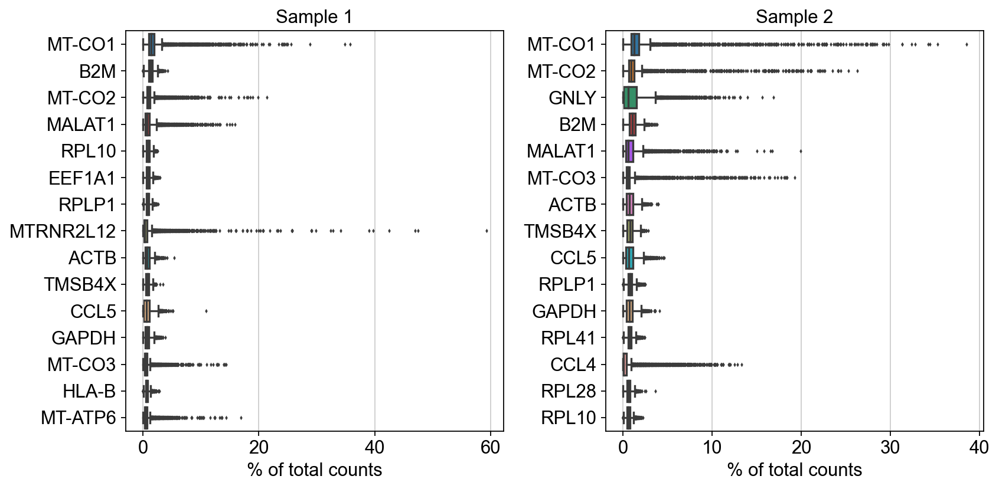

In [6]:
fig, ax = plt.subplots(ncols=len(adatas), figsize=(10,5))
fig.tight_layout(w_pad=3)
for i, adata in enumerate(adatas):
    sc.pl.highest_expr_genes(adata, n_top=15, ax=ax[i], show=False)
    ax[i].set_title(names[i])
fig.savefig('./figures/highest_expr_genes.pdf')

In the next step we will apply some bacic filters to these cells. Therefore we can control for the minimum number of genes per cell, to take this cell into account. A second filter will filter out genes, which are present in less than a certain number of cells.

In [7]:
for adata in adatas:
    sc.pp.filter_cells(adata, min_genes=200)
    sc.pp.filter_genes(adata, min_cells=3)

Note you can also use the function `pp.calculate_qc_metrics` to compute the fraction of mitochondrial genes and additional measures.

In [8]:
for adata in adatas:
    mito_genes = adata.var_names.str.startswith('MT-')
    adata.obs['percent_mito'] = np.sum(
    adata[:, mito_genes].X, axis=1).A1 / np.sum(adata.X, axis=1).A1
    adata.obs['n_counts'] = adata.X.sum(axis=1).A1

In [9]:
for adata in adatas:
    ribo_genes = ((adata.var_names.str.startswith("RPL")) | (adata.var_names.str.startswith("RPS"))| (adata.var_names.str.startswith("MPL")))
    adata.obs['percent_ribo'] = np.sum(
    adata[:, ribo_genes].X, axis=1) / np.sum(adata.X, axis=1)
    adata.var['ribo'] = ribo_genes

In [10]:
y_genes=pd.read_csv("./analysis_info/Ygenes.csv", sep=';')
y_genes_list=y_genes.gene.tolist()
for adata in adatas:
    sc.tl.score_genes(adata, y_genes_list, score_name='male_score')

In [11]:
activation_genes=pd.read_csv("./analysis_info/activation_genes.txt", sep='\t')

In [12]:
activation_gene_list=[x.upper() for x in activation_genes.iloc[:,0].unique().tolist()]
activation_gene_list=activation_gene_list+['CCL4','CCL5','KLRG1','GZMB','GZMK','GZMA','GZMH','XCL1','XCL2','CD82','CD74','PRF1','CD27']+adata.var_names[adata.var_names.str.contains('HLA-D')].tolist()

In [13]:
activation_gene_list_small=['GZMA','GZMB','IFNG','IL2RA','CD27','XCL1','PRF1','CCL4']

In [14]:
for adata in adatas:
    sc.tl.score_genes(adata, activation_gene_list, score_name='activation_score')
    sc.tl.score_genes(adata, activation_gene_list_small, score_name='activation_score_mod')

A violin plot of the computed quality measures.

... storing 'feature_types' as categorical


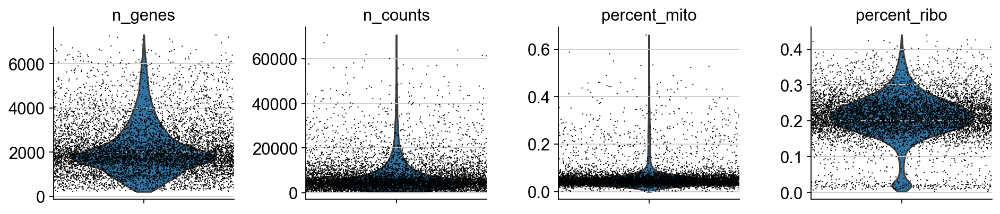

... storing 'feature_types' as categorical


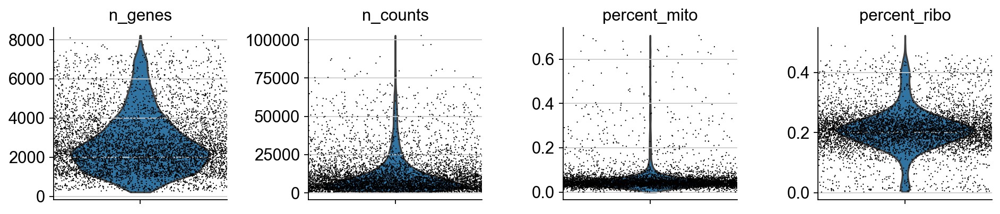

In [15]:
for adata in adatas:
    sc.pl.violin(adata, ['n_genes', 'n_counts', 'percent_mito', 'percent_ribo'],
             jitter=0.5, multi_panel=True)

Remove cells that have too many mitochondrial genes expressed or too many total counts. First, plot the counts versus the percentage of mitochondrial genes and versus the number of genes to define a threshold for later filtering.

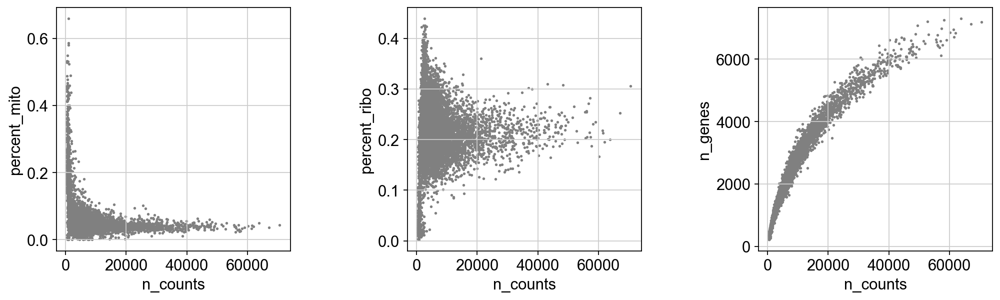

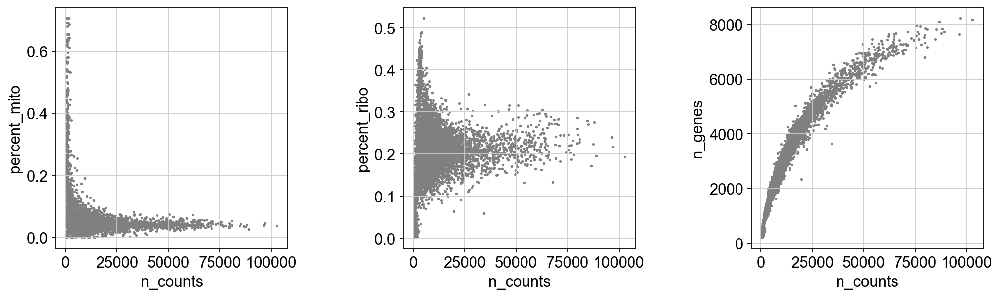

In [16]:
for adata in adatas:
    counts = adata.obs['n_counts']
    mito = adata.obs['percent_mito']
    genes = adata.obs['n_genes']
    ribo = adata.obs['percent_ribo']
    fig = plt.figure(figsize=(15, 4))
    grid = plt.GridSpec(1, 3, hspace=0, wspace=0.5)
    percent_mito = fig.add_subplot(grid[0, 0], xlabel='n_counts', ylabel='percent_mito')
    percent_ribo = fig.add_subplot(grid[0, 1], xlabel='n_counts', ylabel='percent_ribo')
    n_genes = fig.add_subplot(grid[0, 2], xlabel='n_counts', ylabel='n_genes')
    percent_mito.scatter(counts, mito, s=2, c='gray')
    percent_ribo.scatter(counts, ribo, s=2, c='gray')
    n_genes.scatter(counts, genes, s=2, c='gray')

Actually do the filtering from the cut-off defined above.

In [17]:
counts_before=[adatas[0].n_obs, adatas[1].n_obs]
adatas[0] = adatas[0][adatas[0].obs['n_genes'] < 7000, :]
adatas[0] = adatas[0][adatas[0].obs['n_counts'] < 50000, :]
adatas[0] = adatas[0][adatas[0].obs['percent_mito'] < 0.2, :]

adatas[1] = adatas[1][adatas[1].obs['n_genes'] < 7000, :]
adatas[1] = adatas[1][adatas[1].obs['n_counts'] < 50000, :]
adatas[1] = adatas[1][adatas[1].obs['percent_mito'] < 0.2, :]

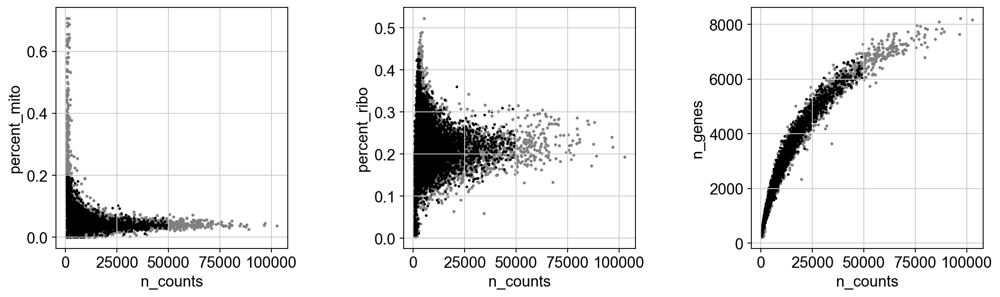

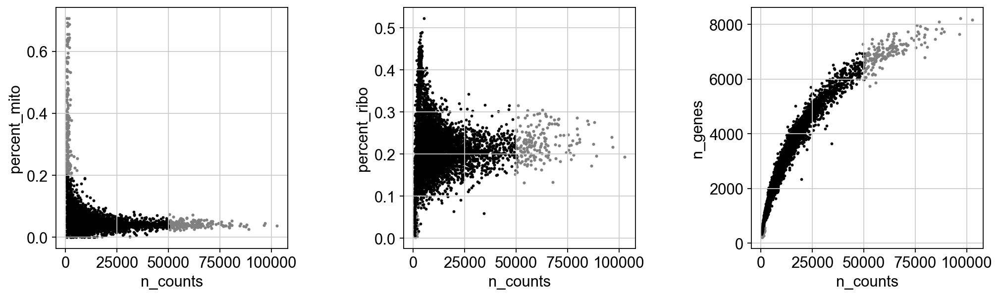

In [18]:
for adata in adatas:
    counts2 = adata.obs['n_counts']
    mito2 = adata.obs['percent_mito']
    genes2 = adata.obs['n_genes']
    ribo2 = adata.obs['percent_ribo']

    fig = plt.figure(figsize=(15, 4))
    grid = plt.GridSpec(1, 3, hspace=0, wspace=0.5)
    percent_mito = fig.add_subplot(grid[0, 0], xlabel='n_counts', ylabel='percent_mito')
    percent_ribo = fig.add_subplot(grid[0, 1], xlabel='n_counts', ylabel='percent_ribo')
    n_genes = fig.add_subplot(grid[0, 2], xlabel='n_counts', ylabel='n_genes')

    percent_mito.scatter(counts, mito, s=3, c='gray')
    percent_ribo.scatter(counts, ribo, s=3, c='gray')
    n_genes.scatter(counts, genes, s=3, c='gray')
    percent_mito.scatter(counts2, mito2, s=2, c='black')
    percent_ribo.scatter(counts2, ribo2, s=2, c='black')
    n_genes.scatter(counts2, genes2, s=2, c='black')

fig.savefig('./figures/filtering.pdf', dpi=2000)

In [19]:
for i, adata in enumerate(adatas):
    print(names[i]+': '+str(counts_before[i])+' --> '+str(adata.n_obs))

Sample 1: 8278 --> 7954
Sample 2: 6283 --> 5902


Total-count normalize (library-size correct) the data matrix to 10,000 reads per cell, so that counts become comparable among cells.

In [20]:
for adata in adatas:
    sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
    sc.pp.log1p(adata)

Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.


Logarithmize the data.

## Cell cycle scoring

In [21]:
cc_genes=pd.read_csv("./analysis_info/regev_lab_cell_cycle_genes.txt")
s_genes=cc_genes[:46]
g2m_genes=cc_genes[47:]
s_genes.columns=['genes']
g2m_genes.columns=['genes']
for adata in adatas:
    sc.tl.score_genes_cell_cycle(adata, s_genes.genes, g2m_genes.genes)

... storing 'phase' as categorical
... storing 'phase' as categorical


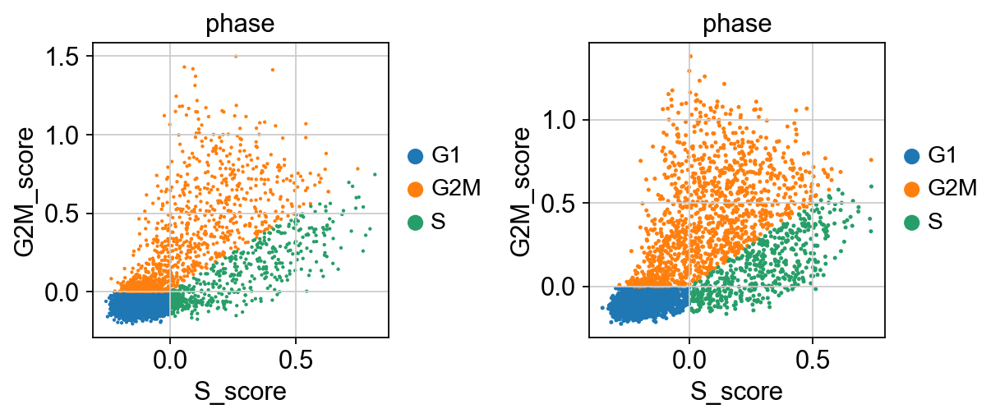

In [22]:
fig, ax = plt.subplots(ncols=len(adatas), figsize=(7,3))
fig.tight_layout(w_pad=5)
for i, adata in enumerate(adatas):
    sc.pl.scatter(adata, x='S_score', y='G2M_score', color='phase', ax=ax[i], show=False)

Set the `.raw` attribute of AnnData object to the logarithmized raw gene expression for later use in differential testing and visualizations of gene expression. This simply freezes the state of the AnnData object. While many people consider the normalized data matrix as the "relevant data" for visualization and differential testing, some would prefer to store the unnormalized data.

In [23]:
for adata in adatas:
    adata.raw = adata

In [24]:
adata=adatas[0].concatenate(adatas[1])

Identify highly-variable genes.

In [25]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

In [26]:
adata = adata[:, adata.var['highly_variable']]
sc.pp.regress_out(adata, ['n_counts', 'percent_mito', 'S_score', 'G2M_score'])
sc.pp.scale(adata, max_value=10)

## Principal component analysis

In [27]:
sc.tl.pca(adata, svd_solver='arpack')

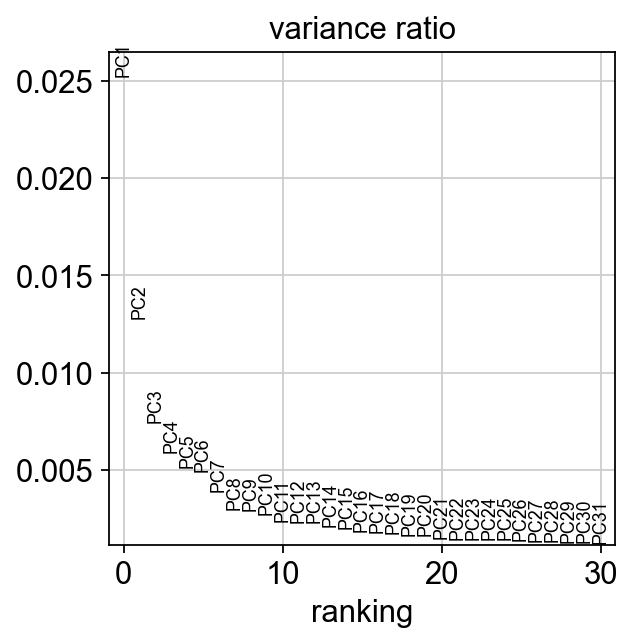

In [28]:
sc.pl.pca_variance_ratio(adata)

## Computing the neighborhood graph

In [29]:
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=7)

## Embedding the neighborhood graph

In [30]:
sc.tl.umap(adata)

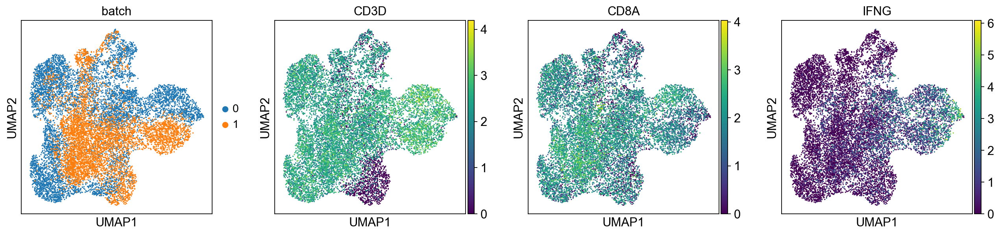

In [31]:
sc.pl.umap(adata, color=['batch', 'CD3D', 'CD8A', 'IFNG'])

## Demultiplexing

In [32]:
Cluster_0_0 = (pd.read_csv("./GEX_1/scSplit/Cluster_0_0.csv", header=None, names=['barcode'])+'-0').barcode.tolist()
Cluster_0_1 = (pd.read_csv("./GEX_1/scSplit/Cluster_0_1.csv", header=None, names=['barcode'])+'-0').barcode.tolist()
Cluster_0_DB = (pd.read_csv("./GEX_1/scSplit/Cluster_0_DB.csv", header=None, names=['barcode'])+'-0').barcode.tolist()

Cluster_1_0 = (pd.read_csv("./GEX_2/scSplit/Cluster_1_0.csv", header=None, names=['barcode'])+'-1').barcode.tolist()
Cluster_1_1 = (pd.read_csv("./GEX_2/scSplit/Cluster_1_1.csv", header=None, names=['barcode'])+'-1').barcode.tolist()
Cluster_1_DB = (pd.read_csv("./GEX_2/scSplit/Cluster_1_DB.csv", header=None, names=['barcode'])+'-1').barcode.tolist()

In [33]:
adata.obs['cluster']=None

In [34]:
adata.obs.cluster[adata.obs_names.isin(Cluster_0_0)]='Cluster_0_0'
adata.obs.cluster[adata.obs_names.isin(Cluster_0_1)]='Cluster_0_1'
adata.obs.cluster[adata.obs_names.isin(Cluster_0_DB)]='Doublets'

adata.obs.cluster[adata.obs_names.isin(Cluster_1_0)]='Cluster_1_0'
adata.obs.cluster[adata.obs_names.isin(Cluster_1_1)]='Cluster_1_1'
adata.obs.cluster[adata.obs_names.isin(Cluster_1_DB)]='Doublets'

In [35]:
SNPs_0=sc.read_csv('./GEX_1/scSplit/alt.csv')
SNPs_1=sc.read_csv('./GEX_2/scSplit/alt.csv')

In [36]:
SNPs_0=SNPs_0.T
sc.pp.normalize_per_cell(SNPs_0, counts_per_cell_after=1e4)
sc.pp.log1p(SNPs_0)

SNPs_1=SNPs_1.T
sc.pp.normalize_per_cell(SNPs_1, counts_per_cell_after=1e4)
sc.pp.log1p(SNPs_1)

In [37]:
SNPs_0.obs['cluster']=None
SNPs_0.obs_names=SNPs_0.obs_names+'-0'

SNPs_1.obs['cluster']=None
SNPs_1.obs_names=SNPs_1.obs_names+'-1'

In [38]:
SNPs_0.obs.cluster[SNPs_0.obs_names.isin(Cluster_0_0)]='Cluster_0_0'
SNPs_0.obs.cluster[SNPs_0.obs_names.isin(Cluster_0_1)]='Cluster_0_1'
SNPs_0.obs.cluster[SNPs_0.obs_names.isin(Cluster_0_DB)]='Doublets'

SNPs_1.obs.cluster[SNPs_1.obs_names.isin(Cluster_1_0)]='Cluster_1_0'
SNPs_1.obs.cluster[SNPs_1.obs_names.isin(Cluster_1_1)]='Cluster_1_1'
SNPs_1.obs.cluster[SNPs_1.obs_names.isin(Cluster_1_DB)]='Doublets'

In [39]:
sc.tl.pca(SNPs_0, svd_solver='arpack')
sc.tl.pca(SNPs_1, svd_solver='arpack')

In [40]:
SNPs_0.obs['male_score']=-1
SNPs_0.obs.male_score[SNPs_0.obs_names.isin(adata.obs_names)]=adata[adata.obs_names.isin(SNPs_0.obs_names)].obs.male_score

... storing 'cluster' as categorical
... storing 'cluster' as categorical


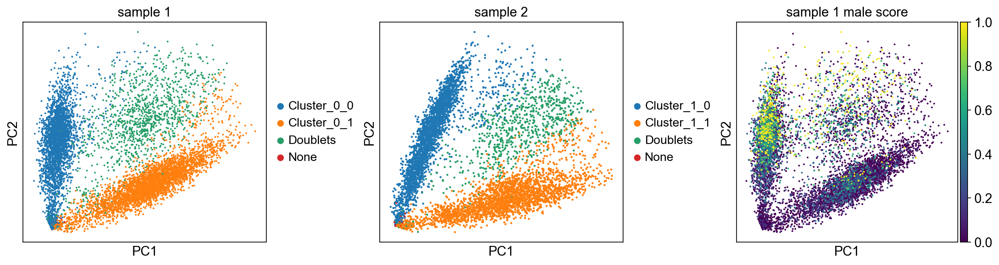

In [41]:
fig, ax = plt.subplots(ncols=3, figsize=(15,4))
fig.tight_layout(w_pad=6)
sc.pl.pca(SNPs_0, color='cluster', ax=ax[0], show=False, title='sample 1')
sc.pl.pca(SNPs_0, color='male_score', ax=ax[2], vmin=0, vmax=1, show=False, title='sample 1 male score')
sc.pl.pca(SNPs_1, color='cluster', ax=ax[1], show=False, title='sample 2')

## Batch effect correction

In [42]:
sc.external.pp.bbknn(adata, batch_key='cluster')
sc.tl.umap(adata, min_dist=0.75)

... storing 'cluster' as categorical


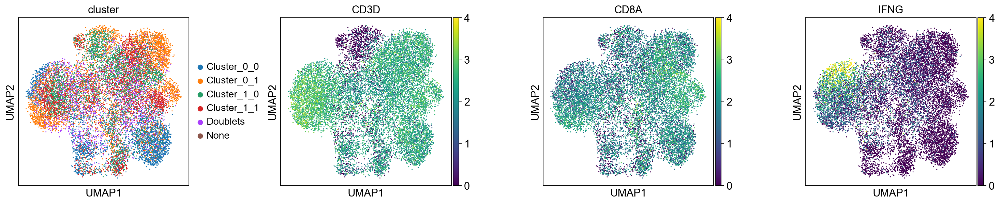

In [43]:
sc.pl.umap(adata, color=['cluster', 'CD3D', 'CD8A', 'IFNG'], vmax=[4,4,4,4], wspace=0.4)

## Clustering the neighborhood graph

In [44]:
from sklearn.metrics import silhouette_score
def titrate_leiden_resolution(adata):
    res_array=list(np.round(np.linspace(.1, 2, 20),1))
    silhoutte_list=list()
    sc.settings.verbosity = 1
    for i,res in enumerate(res_array):
        sc.tl.leiden(adata, resolution=res)
        if adata.obs.leiden.unique().shape[0]>2:
            silhoutte_list.append(silhouette_score(adata.obsm['X_umap'],
                    adata.obs[f'leiden'],
                    metric='euclidean'))
        else:
            silhoutte_list.append(np.nan)
        print(str(np.round(((i+1)/len(res_array))*100,1))+"%", end="\r", flush=True)
    sns.lineplot(res_array, silhoutte_list)
    print(silhoutte_list)

[0.29534197, 0.37967208, 0.33007815, 0.2988768, 0.28789446, 0.29424718, 0.2981164, 0.24676664, 0.23128986, 0.24809915, 0.24805892, 0.20781668, 0.19340892, 0.15032385, 0.15695472, 0.15004091, 0.15121762, 0.11624419, 0.10688099, 0.1180839]


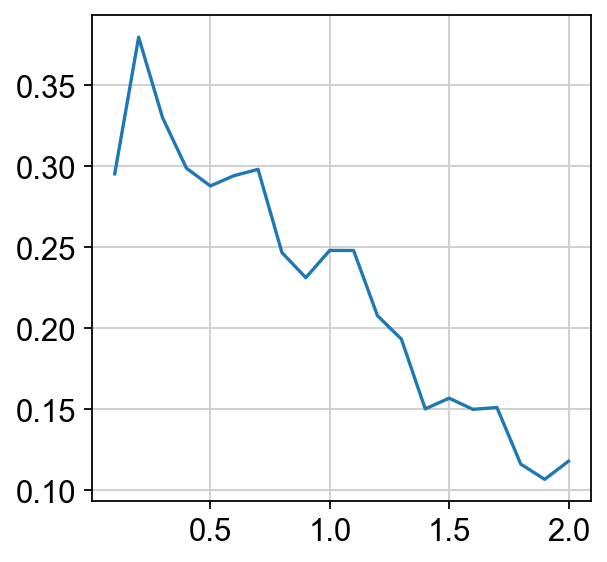

In [45]:
titrate_leiden_resolution(adata)

In [46]:
sc.tl.leiden(adata, resolution=0.5)
print(silhouette_score(adata.obsm['X_umap'],adata.obs[f'leiden'],metric='euclidean'))

0.28789446


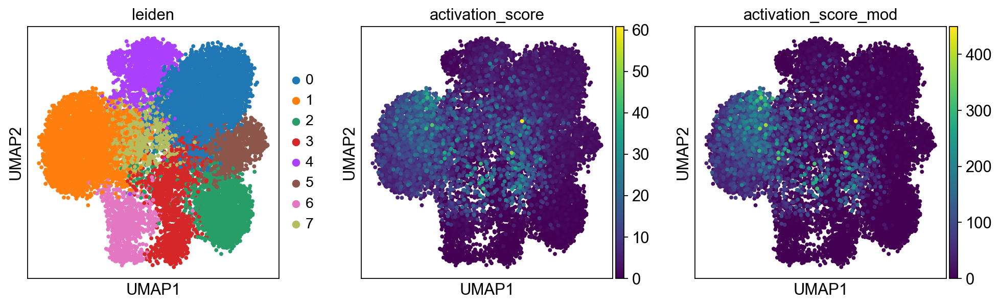

In [47]:
sc.pl.umap(adata, color=['leiden', 'activation_score','activation_score_mod'], vmin=0, save='_leiden.pdf', s=50)

## Donor reallocation

In [48]:
def compare_genotype(genotype, genotype_original, donor, cluster, scorelist):
    score=[0]*10
    other_donors=[i for i in range(len(genotype_original))]
    other_donors.remove(donor)
    other_donors_genotype=pd.concat([genotype_original[i] for i in other_donors], axis=1, sort=False)
    
    other_clusters=[i for i in range(len(genotype))]
    other_clusters.remove(cluster)
    other_clusters_genotype=pd.concat([genotype[i] for i in other_clusters], axis=1, sort=False).drop(['probability','quality'], axis=1)
    
    for i, gene in enumerate(genotype[cluster].index.tolist()):
        for j in range(2):
            if genotype[cluster].loc[gene][j] in genotype_original[donor].loc[gene,['allele_1', 'allele_2']].tolist():
                score[j+(i*2)]=scorelist[0]*genotype[cluster].loc[gene,'probability']
                if genotype[cluster].loc[gene][j] not in other_donors_genotype.loc[gene].tolist():
                    score[j+(i*2)]=scorelist[1]*genotype[cluster].loc[gene,'probability']
                if genotype[cluster].loc[gene][j] not in other_clusters_genotype.loc[gene].tolist():
                    score[j+(i*2)]=scorelist[2]*genotype[cluster].loc[gene,'probability']
                if genotype[cluster].loc[gene][j] not in other_clusters_genotype.loc[gene].tolist() and genotype[cluster].loc[gene][j] not in other_donors_genotype.loc[gene].tolist():
                    score[j+(i*2)]=scorelist[3]*genotype[cluster].loc[gene,'probability']
            if genotype[cluster].loc[gene][j] not in genotype_original[donor].loc[gene,['allele_1', 'allele_2']].tolist():
                score[j+(i*2)]=scorelist[4]*genotype[cluster].loc[gene,'probability']
                if genotype[cluster].loc[gene][j] not in other_donors_genotype.loc[gene].tolist():
                    score[j+(i*2)]=scorelist[5]*genotype[cluster].loc[gene,'probability']
            if genotype[cluster].loc[gene][j] == 'XX':
                score[j+(i*2)]=0
            if genotype[cluster].loc[gene][j]==genotype[cluster].loc[gene][j+1] and genotype_original[donor].loc[gene][j]!=genotype_original[donor].loc[gene][j+1] and score[j+(i*2)]>0:
                    score[j+(i*2)]=score[j+(i*2)]*0.75
    return score

In [49]:
def calculate_allocation_scores(n_Donors, genotypes_path, genotype_original_path, samplename='GEX', vmax=3, scorelist=[1,1.5,2,3,-0.5,-0.25], sex=True, n_cells=True, cellnumbers=[], genders=[], adata=adata, cluster_names=adata.obs.cluster.unique().tolist()):
    n_genotypes=n_Donors+1
    genotype=[None]*n_genotypes
    genotype_ori=pd.read_csv(genotype_original_path, sep=';', dtype='str').fillna('XX')
    genotype_ori.set_index('Allele', inplace=True)
    genotype_original=[None]*n_Donors
    scores={}
    for i in range(n_genotypes):
        genotype[i]=pd.read_csv(genotypes_path+'/HLA_'+str(i)+'/hla.EUR.'+samplename+'.rnaseq.txt', sep=r'\s+').drop(3)
        genotype[i]=genotype[i].drop(genotype[i].columns[[0,1,2,3,9,10,11,12,13,14,15,16,17,18]], axis=1)
        genotype[i].columns=['gene', 'allele_1','allele_2','probability','quality']
        genotype[i].probability=genotype[i].probability.fillna(0.5)
        genotype[i].allele_1=genotype[i].allele_1.fillna('XXXXXXXXXXXXXX')
        genotype[i].allele_1=genotype[i].allele_1.str[-5:-3]
        genotype[i].allele_2=genotype[i].allele_2.fillna('XXXXXXXXXXXXXX')
        genotype[i].allele_2=genotype[i].allele_2.str[-5:-3]
        genotype[i].set_index('gene', inplace=True)

    for i in range(n_Donors):
        genotype_original[i]=genotype_ori.iloc[:,i+(i*1):2+(2*i)]
        genotype_original[i].columns=['allele_1','allele_2']
        scores['Donor '+str(i+1)]= [0]*n_genotypes

    df=pd.DataFrame(index=cluster_names, data=scores)
    for i in range(n_genotypes):
        for j in range(n_Donors):
            df.iloc[i,j]=sum(compare_genotype(genotype, genotype_original, j, i, scorelist))
            if sex==True:
                sex_score=(adata.obs[adata.obs.cluster==cluster_names[i]].male_score.mean()-adata.obs.male_score.mean())*genders[j]
                df.iloc[i,j]=df.iloc[i,j]+sex_score
            if n_cells==True:
                ncell_score=(((adata.obs[adata.obs.cluster==cluster_names[i]].shape[0]-cellnumbers[j])**2)**.5)*0.0005
                df.iloc[i,j]=df.iloc[i,j]-ncell_score
                
    return df, n_genotypes, sns.heatmap(df, annot=True, cmap='viridis', square=True, vmin=0, vmax=vmax)

In [50]:
adata.obs[adata.obs.cluster=='Cluster_1_1'].male_score.mean()-adata.obs.male_score.mean()*5

-0.15648521610181326

(              Donor 1   Donor 2
 Cluster_0_0  0.168328  0.532922
 Cluster_0_1  4.080185 -2.388935
 Doublets     2.170290 -0.127790,
 3,
 <matplotlib.axes._subplots.AxesSubplot at 0x19a9d17bbe0>)

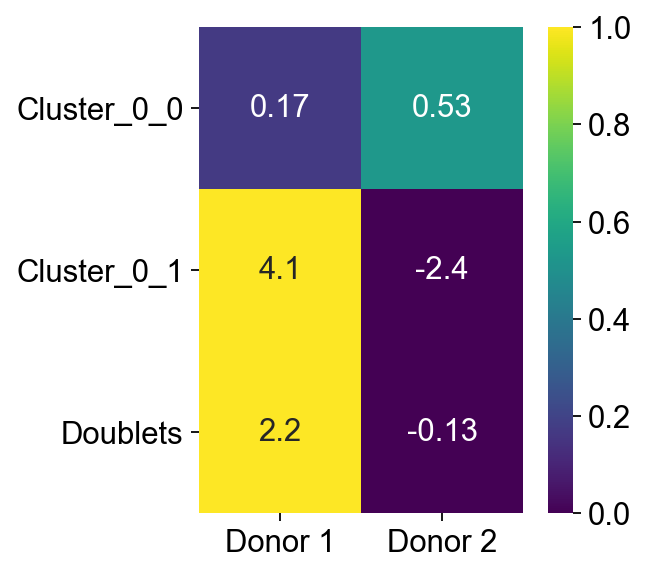

In [51]:
calculate_allocation_scores(2, './GEX_1/scSplit', './GEX_1/scSplit/original_donors.csv', samplename='GEX_1', vmax=1, scorelist=[1,1.5,2,3,-0.5,-0.25], sex=True, n_cells=False, cellnumbers=[3000,3000], genders=[-1,1], cluster_names=['Cluster_0_0', 'Cluster_0_1', 'Doublets'], adata=adata[adata.obs.batch=='0'])

(             Donor 1  Donor 2
 Cluster_1_0   0.1350   2.0350
 Cluster_1_1   0.6750   1.5950
 Doublets      0.7625   0.6825,
 3,
 <matplotlib.axes._subplots.AxesSubplot at 0x19a9ccd7fd0>)

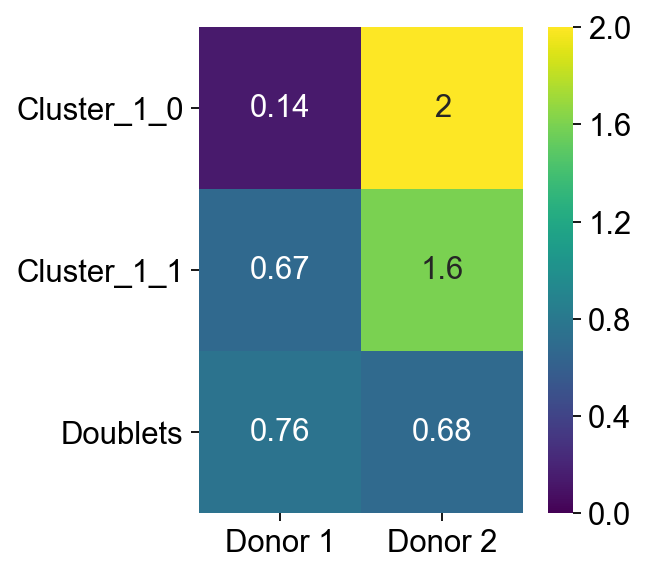

In [52]:
calculate_allocation_scores(2, './GEX_2/scSplit', './GEX_2/scSplit/original_donors.csv', samplename='GEX_2', vmax=2, scorelist=[1,1.5,2,3,-0.5,-0.25], sex=True, n_cells=False, cellnumbers=[3000,3000], genders=[-1,-1], cluster_names=['Cluster_1_0', 'Cluster_1_1', 'Doublets'], adata=adata[adata.obs.batch=='1'])

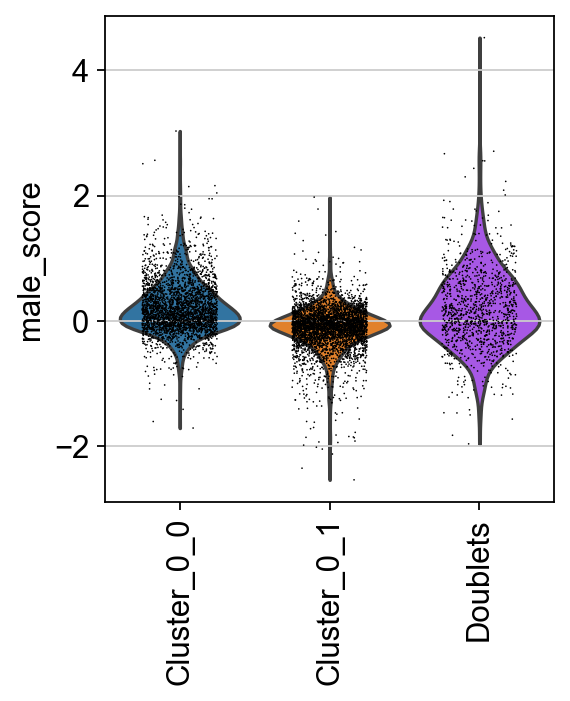

In [53]:
sc.pl.violin(adata[adata.obs.batch=='0'], 'male_score', groupby='cluster', jitter=0.25, size=0.75, rotation=90, save='male_score.pdf')

In [54]:
adata.obs['donor']='not assigned'
adata.obs.donor[adata.obs.cluster=='Cluster_0_0']='HM0045'
adata.obs.donor[adata.obs.cluster=='Cluster_0_1']='HM0040'
adata.obs.donor[adata.obs.cluster=='Cluster_1_0']='HM0043'
adata.obs.donor[adata.obs.cluster=='Cluster_1_1']='HM0034'
adata.obs.donor[adata.obs.cluster=='Doublets']='Doublets'

In [55]:
adata=adata[adata.obs.donor!='not assigned'].copy()

In [56]:
adata_donor1 = adata[adata.obs['donor']=='HM0045',:]
adata_donor2 = adata[adata.obs['donor']=='HM0040',:]
adata_donor3 = adata[adata.obs['donor']=='HM0043',:]
adata_donor4 = adata[adata.obs['donor']=='HM0034',:]

In [57]:
single_donor_adatas=[adata_donor1,adata_donor2,adata_donor3,adata_donor4]
single_donor_adatas_names=['HM0045','HM0040','HM0043','HM0034']

... storing 'donor' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'donor' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'donor' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'donor' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'donor' as categorical


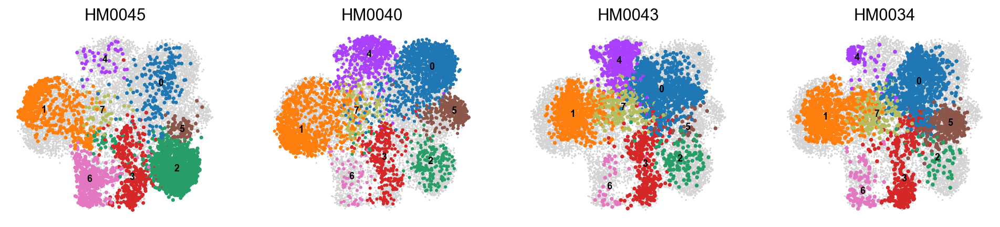

In [58]:
fig, ax = plt.subplots(ncols=4, figsize=(15, 3))
for i, adata_single in enumerate(single_donor_adatas):
    sc.pl.umap(adata, color=None, legend_loc='on data', legend_fontsize=8, frameon=False, ax=ax[i], show=False)
    sc.pl.umap(adata_single, color='leiden', legend_loc='on data', title=single_donor_adatas_names[i], legend_fontsize=8, frameon=False, ax=ax[i], show=False)
fig.savefig('./figures/umaps_donors.pdf')

## Finding marker genes

Let us compute a ranking for the highly differential genes in each cluster. For this, by default, the `.raw` attribute of AnnData is used in case it has been initialized before. The simplest and fastest method to do so is the t-test.

In [59]:
sc.settings.verbosity = 2  # reduce the verbosity

ranking genes
    finished (0:00:03)
    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns["dendrogram_['leiden']"]`


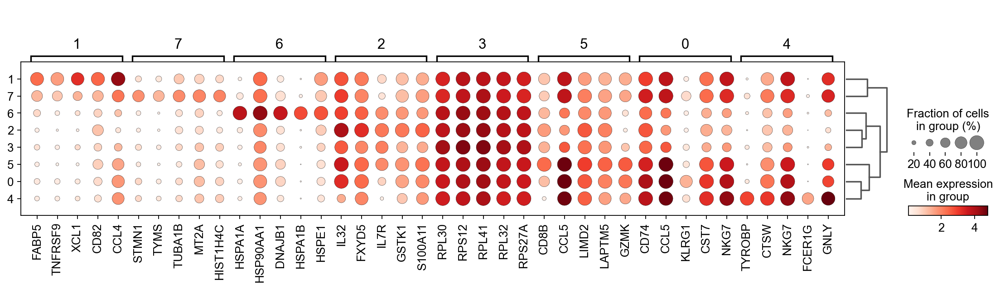

In [60]:
sc.tl.rank_genes_groups(adata, 'leiden', use_raw='true', method='t-test')
sc.pl.rank_genes_groups_dotplot(adata, n_genes=5)

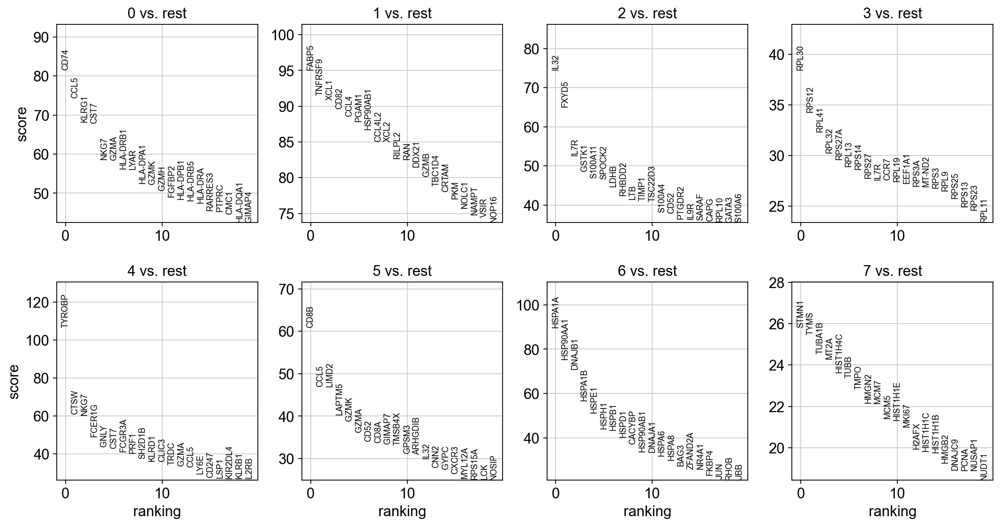

In [61]:
sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False)

In [62]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key: result[key][group]
    for group in groups for key in ['names', 'pvals']}).to_csv('marker_genes.csv')

In [63]:
marker_genes=['CD3D', 'CD3E', 'CD3G', 'CD2', 'CD8A', 'CD8B', 'CD4', 'IL7R', 'XCL1', 'CCR7', 'CCL4', 
              'CCR5','CXCR3', 'GZMB', 'PRF1', 'IL2RA', 'SELL', 'CD27', 'CD69', 'FAS','PDCD1', 'TCF7', 'HAVCR2','LAG3',
              'IFNG', 'IL2', 'IL10', 'TBX21', 'GATA3', 'RORC']

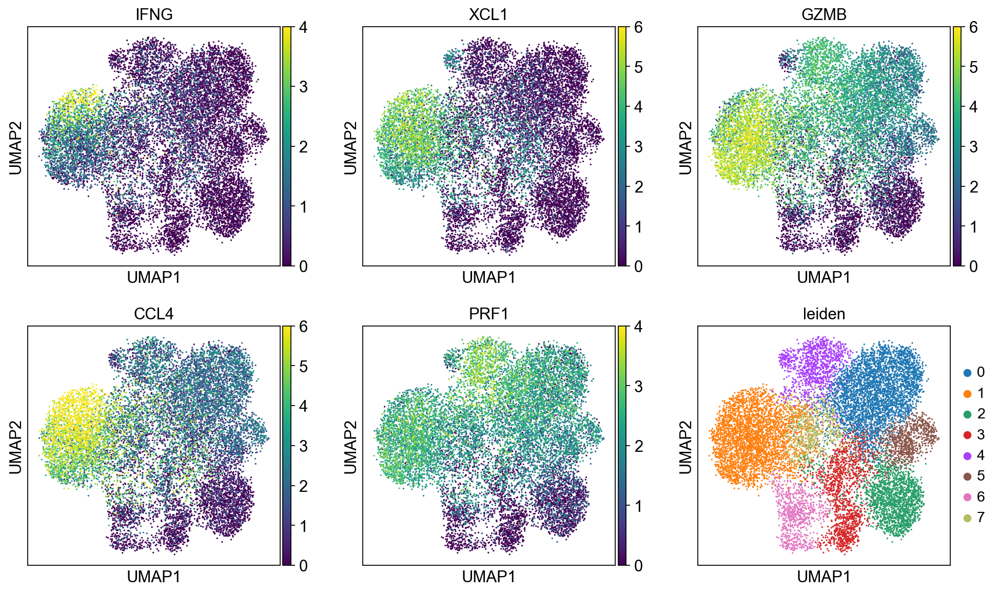

In [64]:
sc.pl.umap(adata, color=['IFNG','XCL1', 'GZMB', 'CCL4', 'PRF1', 'leiden'], ncols=3, vmax=[4,6,6,6,4], save='_activation_marker_genes.pdf')

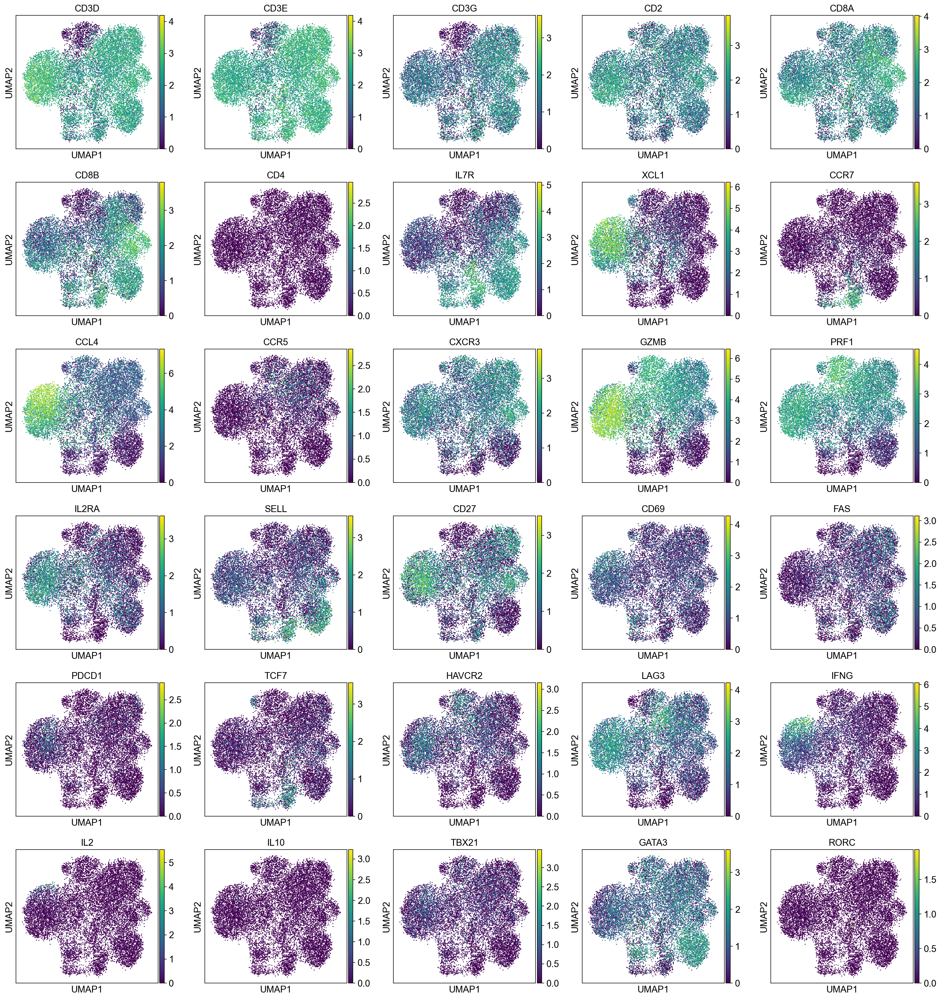

In [65]:
sc.pl.umap(adata, color=marker_genes, ncols=5, save='_marker_genes.pdf')

# TCR analysis scirpy

In [66]:
adata_TCR_1=ir.io.read_10x_vdj('./GEX_1/VDJ/all_contig_annotations.json')
adata_TCR_2=ir.io.read_10x_vdj('./GEX_2/VDJ/all_contig_annotations.json')

... storing 'TRA_1_cdr3' as categorical
... storing 'TRA_2_cdr3' as categorical
... storing 'TRB_1_cdr3' as categorical
... storing 'TRB_2_cdr3' as categorical
... storing 'TRA_1_v_gene' as categorical
... storing 'TRA_2_v_gene' as categorical
... storing 'TRB_1_v_gene' as categorical
... storing 'TRB_2_v_gene' as categorical
... storing 'TRA_1_d_gene' as categorical
... storing 'TRA_2_d_gene' as categorical
... storing 'TRB_1_d_gene' as categorical
... storing 'TRB_2_d_gene' as categorical
... storing 'TRA_1_j_gene' as categorical
... storing 'TRA_2_j_gene' as categorical
... storing 'TRB_1_j_gene' as categorical
... storing 'TRB_2_j_gene' as categorical
... storing 'TRA_1_c_gene' as categorical
... storing 'TRA_2_c_gene' as categorical
... storing 'TRB_1_c_gene' as categorical
... storing 'TRB_2_c_gene' as categorical
... storing 'TRA_1_cdr3_nt' as categorical
... storing 'TRA_2_cdr3_nt' as categorical
... storing 'TRB_1_cdr3_nt' as categorical
... storing 'TRB_2_cdr3_nt' as categori

In [67]:
adata_TCR_1.obs_names = adata_TCR_1.obs_names+'-0'
adata_TCR_2.obs_names = adata_TCR_2.obs_names+'-1'

In [68]:
concat_obs_data=pd.concat([adata_TCR_1.obs,adata_TCR_2.obs])

In [69]:
import anndata
adata_TCR = anndata.AnnData(obs=concat_obs_data)

In [70]:
ir.pp.merge_with_tcr(adata, adata_TCR)

... storing 'multi_chain' as categorical
... storing 'TRA_1_cdr3' as categorical
... storing 'TRA_2_cdr3' as categorical
... storing 'TRB_1_cdr3' as categorical
... storing 'TRB_2_cdr3' as categorical
... storing 'TRA_1_v_gene' as categorical
... storing 'TRA_2_v_gene' as categorical
... storing 'TRB_1_v_gene' as categorical
... storing 'TRB_2_v_gene' as categorical
... storing 'TRA_2_j_gene' as categorical
... storing 'TRA_1_cdr3_nt' as categorical
... storing 'TRA_2_cdr3_nt' as categorical
... storing 'TRB_1_cdr3_nt' as categorical
... storing 'TRB_2_cdr3_nt' as categorical
... storing 'has_tcr' as categorical


In [71]:
ir.tl.chain_pairing(adata)

... storing 'chain_pairing' as categorical


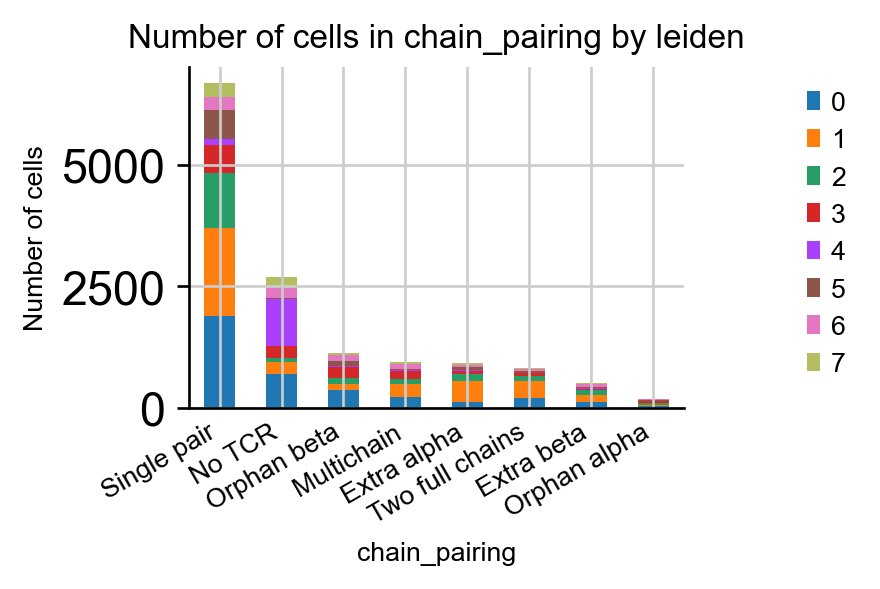

In [72]:
ir.pl.group_abundance(adata, groupby="chain_pairing", target_col="leiden")

In [73]:
adata_small=sc.pp.subsample(adata, n_obs=500, copy=True)

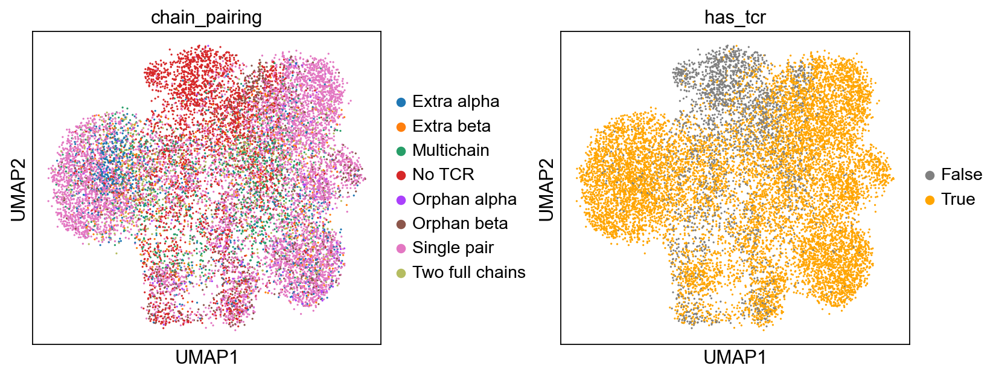

In [74]:
fig, ax = plt.subplots(ncols=2, figsize=(10,4))
fig.tight_layout(w_pad=7)
sc.pl.umap(adata, color="chain_pairing", ax=ax[0], show=False)
sc.pl.umap(adata, color="has_tcr", palette=['gray','orange'], ax=ax[1], show=False)

In [75]:
print('TCR sequencing efficiency: '+str(np.round(adata.obs.has_tcr.value_counts(normalize=True)[1]*100,1))+'%')
print('Unique CDR3 alpha: '+str(adata.obs.TRA_1_cdr3.append(adata.obs.TRA_1_cdr3).nunique()))
print('Unique CDR3 beta: '+str(adata.obs.TRB_1_cdr3.append(adata.obs.TRB_1_cdr3).nunique()))

TCR sequencing efficiency: 19.4%
Unique CDR3 alpha: 2032
Unique CDR3 beta: 2298


In [76]:
print(
    "Fraction of cells with more than one pair of TCRs: {:.2f}".format(
        np.sum(
            adata.obs["chain_pairing"].isin(
                ["Extra beta", "Extra alpha", "Two full chains"]
            )
        )
        / adata.n_obs
    )
)

Fraction of cells with more than one pair of TCRs: 0.16


In [77]:
adata = adata[adata.obs["multi_chain"] != "True", :].copy()

In [78]:
adata_small=sc.pp.subsample(adata, n_obs=5000, copy=True)

In [79]:
ir.pp.tcr_neighbors(adata, receptor_arms="all", dual_tcr="all")
ir.tl.define_clonotypes(adata)

Initializing TcrNeighbors object...
Finished initalizing TcrNeighbors object.  (0:00:02)
Computing TRA pairwise distances...
Finished computing TRA pairwise distances. (0:00:00)
Computing TRB pairwise distances...
Finished computing TRB pairwise distances. (0:00:00)
Started comstructing TRA coord-dictionary...


100%|█████████████████████████████████████████████████████████████████████████████| 2276/2276 [00:12<00:00, 187.71it/s]


Finished constructing TRA coord-dictionary (0:00:12)
Started comstructing TRB coord-dictionary...


100%|█████████████████████████████████████████████████████████████████████████████| 2513/2513 [00:08<00:00, 295.86it/s]


Finished constructing TRB coord-dictionary (0:00:08)
Constructing cell x cell distance matrix...


100%|█████████████████████████████████████████████████████████████████████| 3372159/3372159 [00:33<00:00, 99578.66it/s]


Finished constructing cell x cell distance matrix.  (0:00:33)


... storing 'clonotype' as categorical


array([<matplotlib.axes._subplots.AxesSubplot object at 0x0000019BC3C15198>,
      dtype=object)

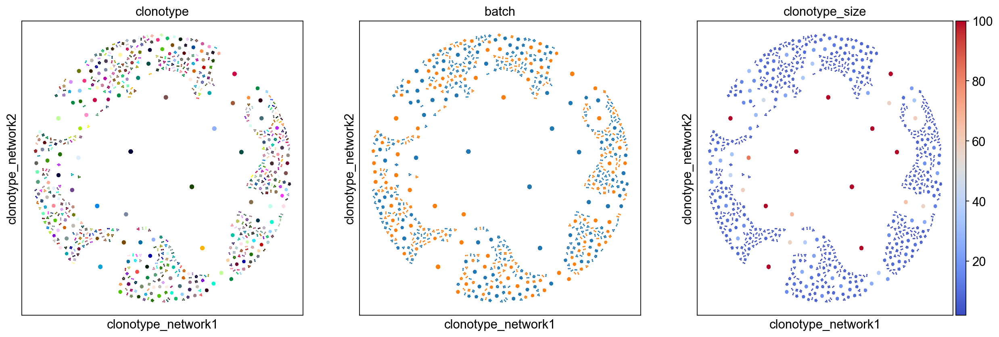

In [80]:
ir.tl.clonotype_network(adata, layout='fr', min_size=2)
ir.pl.clonotype_network(adata, color=["clonotype","batch","clonotype_size"], legend_loc="none", color_map="coolwarm",vmax=100, panel_size=(6, 6), size=10)

In [81]:
ir.pp.tcr_neighbors(adata, receptor_arms="all", dual_tcr="all", metric="identity", sequence="aa")
ir.tl.define_clonotype_clusters(adata, metric="identity", sequence="aa")

Initializing TcrNeighbors object...
Finished initalizing TcrNeighbors object.  (0:00:02)
Computing TRA pairwise distances...
Finished computing TRA pairwise distances. (0:00:00)
Computing TRB pairwise distances...
Finished computing TRB pairwise distances. (0:00:00)
Started comstructing TRA coord-dictionary...


100%|█████████████████████████████████████████████████████████████████████████████| 2234/2234 [00:12<00:00, 184.82it/s]


Finished constructing TRA coord-dictionary (0:00:12)
Started comstructing TRB coord-dictionary...


100%|█████████████████████████████████████████████████████████████████████████████| 2503/2503 [00:08<00:00, 294.50it/s]


Finished constructing TRB coord-dictionary (0:00:08)
Constructing cell x cell distance matrix...


100%|████████████████████████████████████████████████████████████████████| 3374979/3374979 [00:32<00:00, 104758.68it/s]


Finished constructing cell x cell distance matrix.  (0:00:32)


... storing 'ct_cluster_aa_identity' as categorical


array([<matplotlib.axes._subplots.AxesSubplot object at 0x0000019B61106D30>,
      dtype=object)

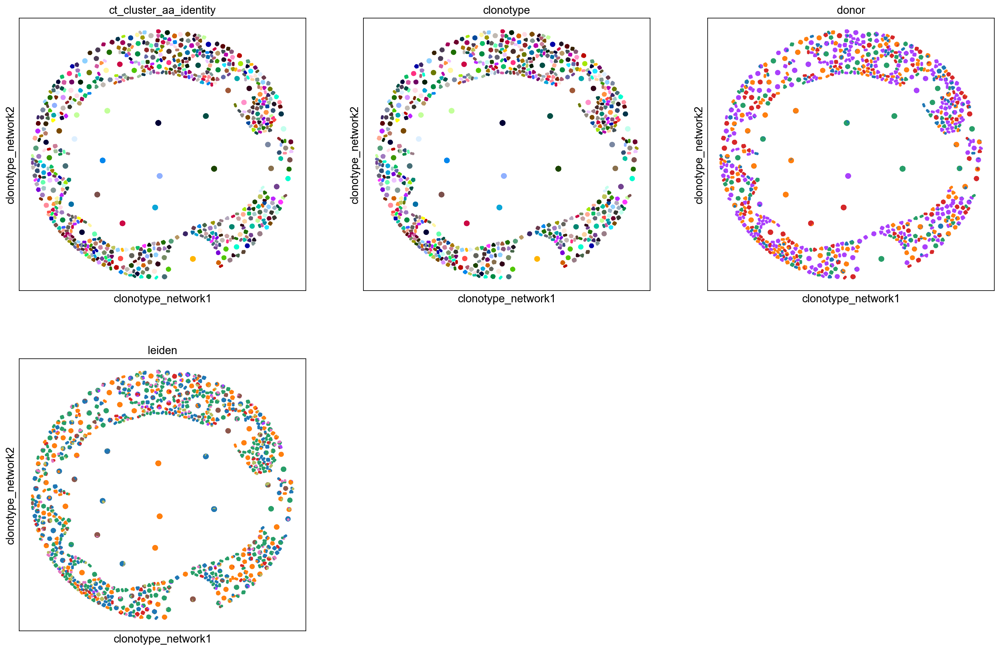

In [82]:
ir.tl.clonotype_network(adata, layout="fr", metric="identity", sequence="aa", min_size=2)
ir.pl.clonotype_network(adata, color=["ct_cluster_aa_identity", "clonotype", "donor", "leiden"], legend_loc="none", panel_size=(7, 7), size=50)

In [83]:
ir.pp.tcr_neighbors(
    adata,
    metric="alignment",
    sequence="aa",
    cutoff=0.5,
    receptor_arms="all",
    dual_tcr="any",
    n_jobs=8
)
ir.tl.define_clonotype_clusters(
    adata, partitions='connected', sequence="aa", metric="alignment"
)

Initializing TcrNeighbors object...
Finished initalizing TcrNeighbors object.  (0:00:02)
Computing TRA pairwise distances...


100%|█████████████████████████████████████████████████████████████████████████████| 2234/2234 [00:22<00:00, 101.52it/s]


Finished computing TRA pairwise distances. (0:00:22)
Computing TRB pairwise distances...


100%|█████████████████████████████████████████████████████████████████████████████| 2503/2503 [00:23<00:00, 106.49it/s]


Finished computing TRB pairwise distances. (0:00:23)
Started comstructing TRA coord-dictionary...


100%|█████████████████████████████████████████████████████████████████████████████| 2234/2234 [00:12<00:00, 184.33it/s]


Finished constructing TRA coord-dictionary (0:00:12)
Started comstructing TRB coord-dictionary...


100%|█████████████████████████████████████████████████████████████████████████████| 2503/2503 [00:08<00:00, 295.88it/s]


Finished constructing TRB coord-dictionary (0:00:08)
Constructing cell x cell distance matrix...


100%|█████████████████████████████████████████████████████████████████████| 3374979/3374979 [00:46<00:00, 73325.29it/s]


Finished constructing cell x cell distance matrix.  (0:00:46)


... storing 'ct_cluster_aa_alignment' as categorical


array([<matplotlib.axes._subplots.AxesSubplot object at 0x0000019B61409128>,
      dtype=object)

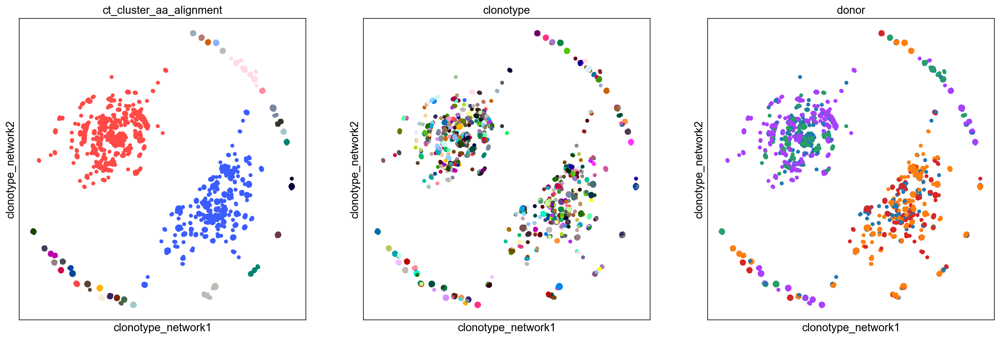

In [84]:
ir.tl.clonotype_network(adata, layout="fr", metric="alignment", sequence="aa", min_size=10)
ir.pl.clonotype_network(adata, color=["ct_cluster_aa_alignment", "clonotype", "donor"], 
                        legend_loc="none", panel_size=(7, 7), size=100)

In [85]:
adata_donor1 = adata[adata.obs['donor']=='HM0045',:]
adata_donor2 = adata[adata.obs['donor']=='HM0040',:]
adata_donor3 = adata[adata.obs['donor']=='HM0043',:]
adata_donor4 = adata[adata.obs['donor']=='HM0034',:]

In [86]:
single_donor_adatas=[adata_donor1,adata_donor2,adata_donor3,adata_donor4]
single_donor_adatas_names=['HM0045','HM0040','HM0043','HM0034']

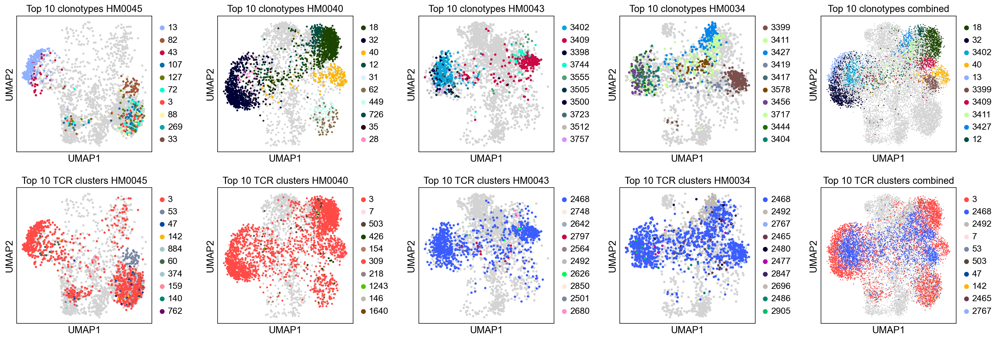

In [87]:
fig, ax =plt.subplots(ncols=len(single_donor_adatas)+1, nrows=2, figsize=(20,7))
fig.tight_layout(w_pad=4, h_pad=2)
for i, adata_s in enumerate (single_donor_adatas):
    sc.pl.umap(adata_s, color='ct_cluster_aa_alignment', 
               groups=adata_s.obs.ct_cluster_aa_alignment.value_counts().index[:10].astype(str).tolist(), 
               ax=ax[1,i], show=False, title='Top 10 TCR clusters '+single_donor_adatas_names[i])
    sc.pl.umap(adata_s, color='clonotype', 
               groups=adata_s.obs.clonotype.value_counts().index[:10].astype(str).tolist(), 
               ax=ax[0,i], show=False, title='Top 10 clonotypes '+single_donor_adatas_names[i])
sc.pl.umap(adata, color='ct_cluster_aa_alignment', 
           groups=adata.obs.ct_cluster_aa_alignment.value_counts().index[:10].astype(str).tolist(), 
           ax=ax[1,4], show=False, title='Top 10 TCR clusters combined')
sc.pl.umap(adata, color='clonotype', 
           groups=adata.obs.clonotype.value_counts().index[:10].astype(str).tolist(), 
           ax=ax[0,4], show=False, title='Top 10 clonotypes combined')
fig.savefig('./figures/clonotypes_clusters_donors.svg')

Text(110.27777777777779, 0.5, '# cells')

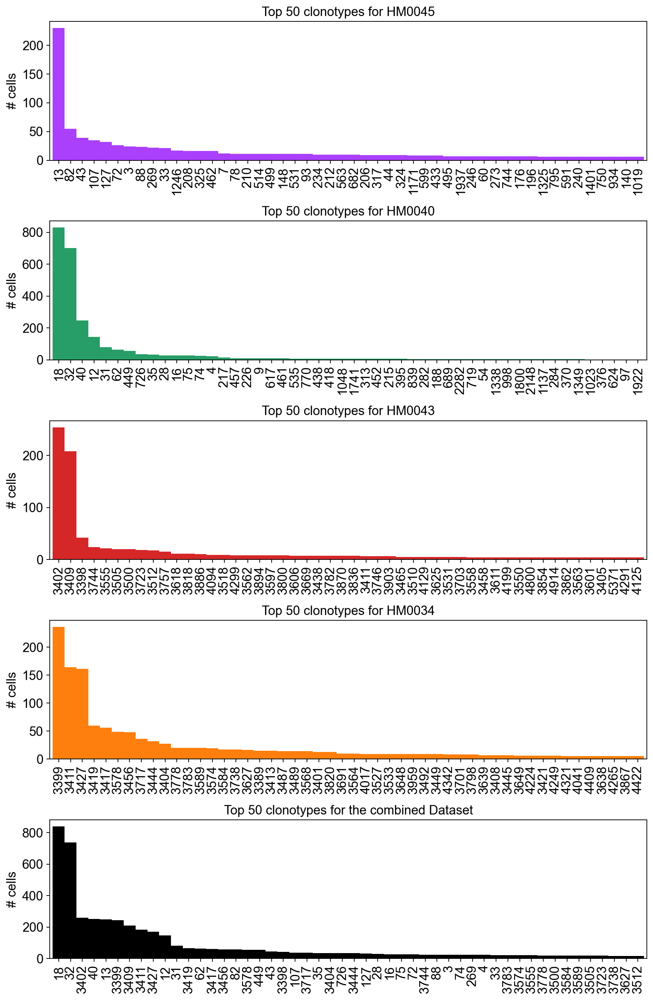

In [88]:
fig, ax=plt.subplots(nrows=5, figsize=(10,15))
fig.tight_layout(h_pad=3)
for i, adata_s in enumerate(single_donor_adatas):
    adata_s.obs.clonotype.value_counts().sort_values(ascending=False)[:50].plot(kind='bar', ax=ax[i], width=1, color=adata_s.uns['donor_colors'][0])
    ax[i].grid(False)
    ax[i].set_title('Top 50 clonotypes for '+single_donor_adatas_names[i])
    ax[i].set_ylabel('# cells')
    #ax[i].set_ylim(0,900)
adata.obs.clonotype.value_counts().sort_values(ascending=False)[:50].plot(kind='bar', ax=ax[4], width=1, color = 'black')
ax[4].grid(False)
ax[4].set_title('Top 50 clonotypes for the combined Dataset')
ax[4].set_ylabel('# cells')

Text(23.877777777777773, 0.5, '# cells')

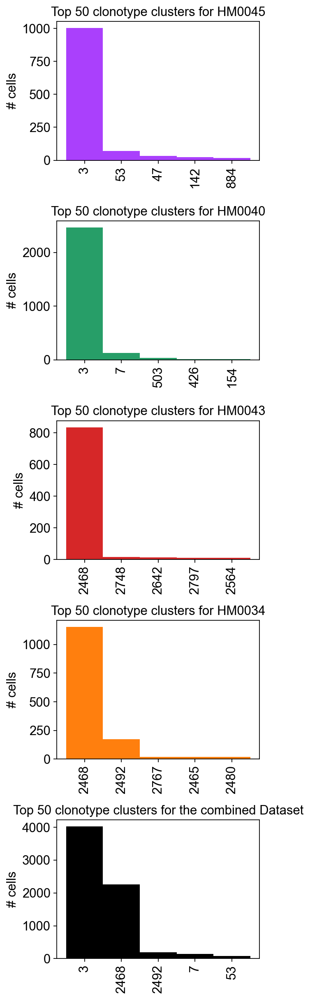

In [89]:
fig, ax=plt.subplots(nrows=5, figsize=(4,15))
fig.tight_layout(h_pad=3)
for i, adata_s in enumerate(single_donor_adatas):
    adata_s.obs.ct_cluster_aa_alignment.value_counts().sort_values(ascending=False)[:5].plot(kind='bar', ax=ax[i], width=1, color=adata_s.uns['donor_colors'][0])
    ax[i].grid(False)
    ax[i].set_title('Top 50 clonotype clusters for '+single_donor_adatas_names[i])
    ax[i].set_ylabel('# cells')
    #ax[i].set_ylim(0,900)
adata.obs.ct_cluster_aa_alignment.value_counts().sort_values(ascending=False)[:5].plot(kind='bar', ax=ax[4], width=1, color = 'black')
ax[4].grid(False)
ax[4].set_title('Top 50 clonotype clusters for the combined Dataset')
ax[4].set_ylabel('# cells')

In [90]:
groups=[str(i) for i in adata.obs[np.logical_and(adata.obs.ct_cluster_aa_alignment_size>50,
                                 ~adata.obs.chain_pairing.isin(['Orphan beta', 'Orphan alpha', 'No TCR']))].ct_cluster_aa_alignment.unique()]

In [91]:
interesting_clonotypes=["13","18","28","32","40","43","82","3398","3399","3409","3417","3427","3456"]

In [92]:
adata.obs[adata.obs.clonotype.isin(interesting_clonotypes)].to_csv("interesting_clonottypes.csv")
adata.obs.to_csv("all_clonottypes.csv")

In [93]:
ir.tl.clonal_expansion(adata, clip_at=1000)
adata.obs['clonal_expansion']=adata.obs['clonal_expansion'].astype(int)

In [94]:
adata.obs[adata.obs.ct_cluster_aa_alignment_size>=2].to_csv('clonotypes.csv')
adata.obs.to_csv('all_clonotypes.csv')

In [95]:
adata.write('./write/COVID_I.h5ad')